In [1]:
import numpy as np
import numpy.typing as npt
import seaborn as sns
import tifffile as tiff
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
import os
import cv2
from scipy.stats import skew
import sys
import numpy.typing as npt


import hdbscan
import umap
import umap.plot


import torch
import torchvision
import gc

In [2]:
%load_ext autoreload
%autoreload 2


import importlib  
au = importlib.import_module("cell-AAP.cell_AAP.annotation.annotation_utils")
sys.path.append('/home/anishjv/cell_seg_classify/notebooks/cell-AAP/cell_AAP/annotation/')
sys.path.append('/home/anishjv/cell_seg_classify/notebooks/cell-AAP/')
ann = importlib.import_module("cell-AAP.cell_AAP.annotation.annotator")
dw = importlib.import_module("cell-AAP.cell_AAP.annotation.dataset_write")
cfg = importlib.import_module("cell-AAP.cell_AAP.configs")

In [3]:
sys.path.append("..")
from segment_anything import sam_model_registry, SamPredictor
from segment_anything.modeling import Sam

#Code below should be run if file is not already saved in path 
#!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth

sam_checkpoint = "vit_l.pt"
model_type = "vit_l"
device = 'cuda'
sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device = device)
predictor = SamPredictor(sam)

In [5]:
import glob

root = '/nfs/turbo/umms-ajitj/anishjv/Cell-AAP/raw-data/'

paths = [
    '20250321-cellapp-data/20250321-U20S-cellapp-f0-t3/pPS18/2025-03-21/20385/',
    '20250321-cellapp-data/20250321-U20S-cellapp-f1-t3/pPS18/2025-03-21/20386/',
    '20250321-cellapp-data/20250321-U20S-cellapp-f2-t3/pPS18/2025-03-21/20387/',
    '20250321-cellapp-data/20250321-U20S-cellapp-f0-t2/pPS18/2025-03-21/20382/',
    '20250321-cellapp-data/20250321-U20S-cellapp-f1-t2/pPS18/2025-03-21/20383/',
    '20250321-cellapp-data/20250321-U20S-cellapp-f2-t2/pPS18/2025-03-21/20384/'
    
]

fluoro_files = []
phs_files = []
for path in paths:
    fluoro_files += glob.glob(root + path + '*Texas Red.tif')
    phs_files += glob.glob(root + path + '*phs.tif')

fluoro_files.sort()
phs_files.sort()

train_phs_files = [file for file in phs_files if 'B08' not in file]
test_phs_files = [file for file in phs_files if 'B08' in file ]

train_fluoro_files = [file for file in fluoro_files if 'B08' not in file]
test_fluoro_files = [file for file in fluoro_files if 'B08' in file ]

phs_files = train_phs_files + test_phs_files
fluoro_files = train_fluoro_files + test_fluoro_files 


In [6]:
%%time
configs = cfg.Cfg.get_config()
configs.frame_step = 1
configs.iou_thresh = 0.95
configs.box_size = (au.get_box_size, (2,))

def sd_intensity(regionmask, intensity_image):
        return np.std(intensity_image[regionmask])

instance_whole = ann.Annotator.get(configs,fluoro_files,phs_files)

df_whole = instance_whole.crop(predictor = predictor).gen_df(extra_props = (sd_intensity,))

The bounding box side length was 102.73048416744442 pixels
input list: 201
input list: 199
poped indices:2
The bounding box side length was 104.91853243653573 pixels
input list: 186
input list: 180
poped indices:16
The bounding box side length was 103.95903749123751 pixels
input list: 202
input list: 199
poped indices:6
The bounding box side length was 109.09842389872594 pixels
input list: 245
input list: 245
poped indices:0
The bounding box side length was 104.51708958052653 pixels
input list: 272
input list: 270
poped indices:2
The bounding box side length was 107.68159242261717 pixels
input list: 309
input list: 308
poped indices:1
The bounding box side length was 104.19776380592295 pixels
input list: 239
input list: 235
poped indices:5
The bounding box side length was 100.70695224280423 pixels
input list: 234
input list: 230
poped indices:4
The bounding box side length was 107.42794374182438 pixels
input list: 242
input list: 242
poped indices:0
The bounding box side length was 102

In [9]:
np.save('embeddings/u2os.npy', df_whole)
np.save('embeddings/u2os_crops.npy', instance_whole.roi)

In [6]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.3])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)
    
    
def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='red', facecolor=(0,0,0,0), lw=1))

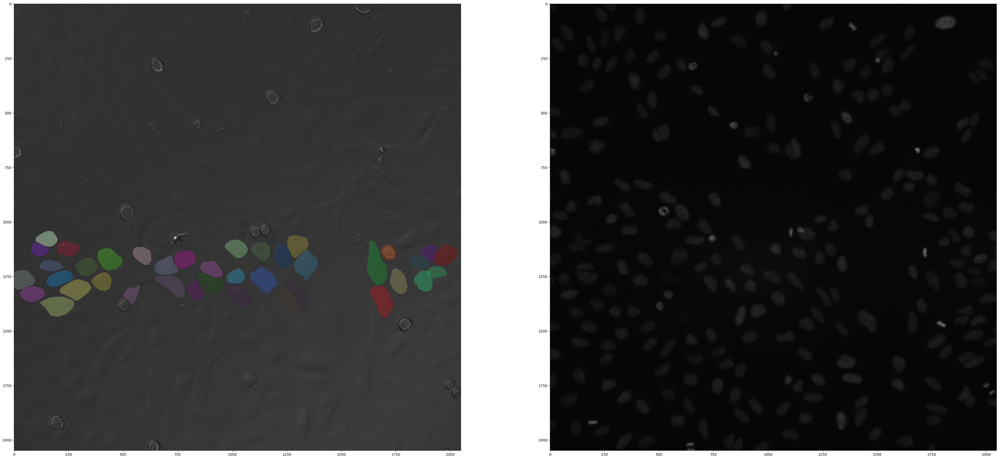

In [97]:
fig, ax = plt.subplots(ncols = 2, figsize = (50,50))

ax[0].imshow(au.bw_to_rgb(instance_whole.phase_image_stack[22]))
ax[1].imshow(au.bw_to_rgb(instance_whole.dna_image_stack[22]))

for i in range(40):
    i+=100
    mask = np.unpackbits(instance_whole.segmentations[22][i], axis = 0, count = 2048)
    mask = np.array([mask]).astype('uint8')
    show_mask(mask, ax[0], random_color = True)

plt.show()

In [7]:
df_mapper = umap.UMAP(n_neighbors=15,
                   min_dist=0,
                   n_components=2,
                   random_state=40,).fit(df_whole)#42

df_embedding = df_mapper.fit_transform(df_whole)

/home/anishjv/.local/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [8]:
labels_whole_embedding = hdbscan.HDBSCAN(min_samples=3,
                                        min_cluster_size = int((1/50) * df_whole.shape[0]),
                                        ).fit_predict(df_embedding)

df_whole_labeled = au.add_labels(df_whole, labels_whole_embedding)

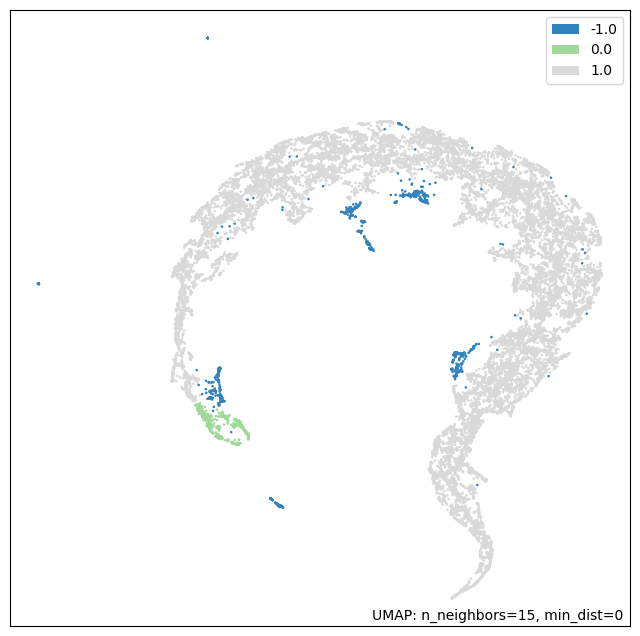

In [9]:
fig = umap.plot.points(df_mapper, labels = df_whole_labeled[:, -1], theme = 'green').get_figure()

In [10]:
clusters = au.write_clusters(df_whole_labeled, -1)
for cluster in clusters.values():
    print(cluster.shape)

(599, 2)
(17869, 2)
(861, 2)


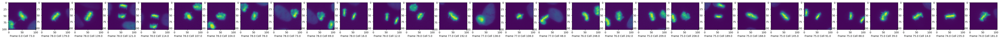

In [11]:
fig, ax = plt.subplots(ncols = 30, figsize = (70,70))

for i in range(30):
    ax[i].imshow(instance_whole.roi[int(clusters[0][-i, 0])][int(clusters[0][-i, 1])])
    ax[i].set_xlabel(f'Frame {clusters[0][-i, 0]} Cell {clusters[0][-i, 1]}')

plt.show()

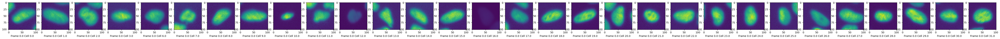

In [12]:
fig, ax = plt.subplots(ncols = 30, figsize = (70,70))

for i in range(30):
    ax[i].imshow(instance_whole.roi[int(clusters[1][i, 0])][int(clusters[1][i, 1])])
    ax[i].set_xlabel(f'Frame {clusters[1][i, 0]} Cell {clusters[1][i, 1]}')

plt.show()

In [ ]:
fig, ax = plt.subplots(ncols = 30, figsize = (70,70))

for i in range(30):
    ax[i].imshow(instance_whole.roi[int(clusters[2][-i, 0])][int(clusters[2][-i, 1])])
    ax[i].set_xlabel(f'Frame {clusters[2][-i, 0]} Cell {clusters[2][-i, 1]}')

plt.show()

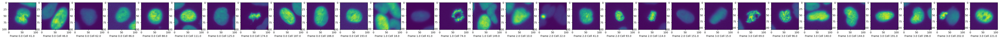

In [14]:
fig, ax = plt.subplots(ncols = 30, figsize = (70,70))

for i in range(30):
    ax[i].imshow(instance_whole.roi[int(clusters["noise"][i, 0])][int(clusters["noise"][i, 1])])
    ax[i].set_xlabel(f'Frame {clusters["noise"][i, 0]} Cell {clusters["noise"][i, 1]}')

plt.show()

# Reclustering the "noise" group

In [15]:
df_noise = df_whole_labeled[df_whole_labeled[:, -1] == -1]
df_noise = df_noise[:, 0:-1]

In [16]:
recluster_mapper = umap.UMAP(n_neighbors=15,
                   min_dist=0,
                   n_components=2,
                   random_state=42,).fit(df_noise)

recluster_embedding = recluster_mapper.fit_transform(df_noise)

/home/anishjv/.local/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [17]:
labeled_recluster_embedding = hdbscan.HDBSCAN(min_samples=10,
                                        min_cluster_size = int((1/30) * df_noise.shape[0]),
                                        ).fit_predict(recluster_embedding)

df_noise_labeled = au.add_labels(df_noise, labeled_recluster_embedding)

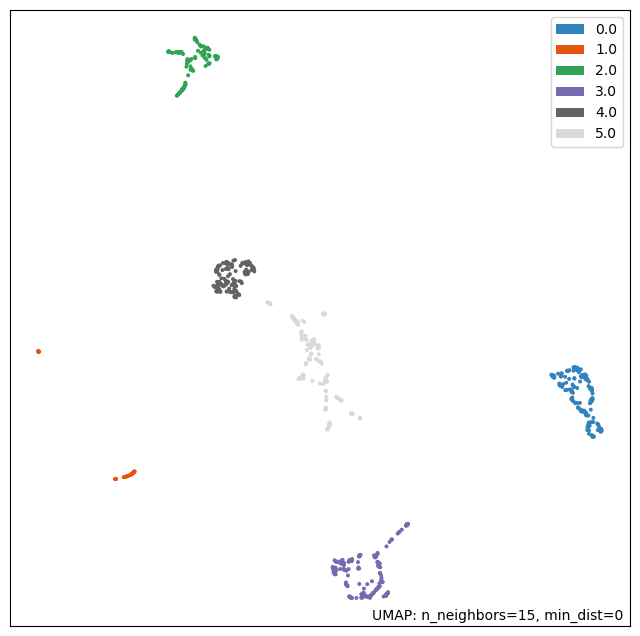

In [18]:
fig = umap.plot.points(recluster_mapper, labels = df_noise_labeled[:, -1], theme = "green").get_figure()

In [19]:
noise_clusters = au.write_clusters(df_noise_labeled, -1)
for cluster in noise_clusters.values():
    print(cluster.shape)

(170, 2)
(40, 2)
(128, 2)
(191, 2)
(138, 2)
(194, 2)
(0, 2)


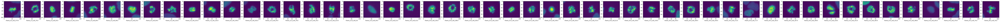

In [20]:
fig, ax = plt.subplots(ncols = 50, figsize = (150, 150))

for i in range(50):
    ax[i].imshow(instance_whole.roi[int(noise_clusters[0][i, 0])][int(noise_clusters[0][i, 1])])
    ax[i].set_xlabel(f'Frame_{noise_clusters[0][i, 0]}_cell_{noise_clusters[0][i, 1]}')

plt.show()

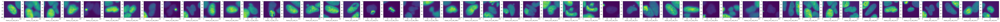

In [21]:
fig, ax = plt.subplots(ncols = 50, figsize = (150, 150))

for i in range(50):
    ax[i].imshow(instance_whole.roi[int(noise_clusters[2][i, 0])][int(noise_clusters[2][i, 1])])
    ax[i].set_xlabel(f'Frame_{noise_clusters[2][i, 0]}_cell_{noise_clusters[2][i, 1]}')

plt.show()

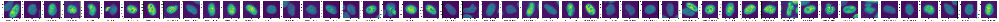

In [22]:
fig, ax = plt.subplots(ncols = 50, figsize = (150, 150))

for i in range(50):
    ax[i].imshow(instance_whole.roi[int(noise_clusters[3][i, 0])][int(noise_clusters[3][i, 1])])
    ax[i].set_xlabel(f'Frame_{noise_clusters[3][i, 0]}_cell_{noise_clusters[3][i, 1]}')

plt.show()

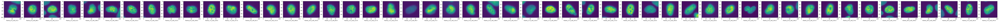

In [23]:
fig, ax = plt.subplots(ncols = 50, figsize = (150, 150))

for i in range(50):
    ax[i].imshow(instance_whole.roi[int(noise_clusters[4][i, 0])][int(noise_clusters[4][i, 1])])
    ax[i].set_xlabel(f'Frame_{noise_clusters[4][i, 0]}_cell_{noise_clusters[4][i, 1]}')

plt.show()

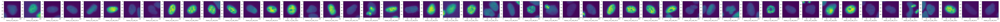

In [24]:
fig, ax = plt.subplots(ncols = 50, figsize = (150, 150))

for i in range(50):
    ax[i].imshow(instance_whole.roi[int(noise_clusters[5][i, 0])][int(noise_clusters[5][i, 1])])
    ax[i].set_xlabel(f'Frame_{noise_clusters[5][i, 0]}_cell_{noise_clusters[5][i, 1]}')

plt.show()

In [25]:
for i in range(df_whole_labeled.shape[0]):
    if df_whole_labeled[i, -1] in [0]:
        df_whole_labeled[i, -1] = 1 #mitotic
    else:
        df_whole_labeled[i, -1] = 0 #non-mitotic

In [26]:
for i in range(df_whole_labeled.shape[0]):
    if (df_whole_labeled[i, -3:-1] == noise_clusters[0]).all(1).any():
        df_whole_labeled[i, -1] = 1 # mitotic

In [28]:
phase_image_stack = instance_whole.phase_image_stack
segmentations = instance_whole.segmentations

splits = [
    (0, 67),
    (68, 78)
] #Breaks the dataset into testing and validation subsets by index of the phase_image_stack. In other words,
  # we split the dataset into subsets by image. You can have as many subsets as you desire. 

dw.write_dataset_ranges(
    '/home/anishjv/cell_seg_classify/',
    phase_image_stack,
    segmentations,
    df_whole_labeled,
    splits,
    'U2OS_0.8',
    {0: 'nonmitotic', 1: 'mitotic'} #Dictionary mapping label in the dataset to category name
)